# Environment Set Up

In [ ]:
from google.colab import drive

drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

#Data Collection

In [ ]:
df = pd.read_csv("/content/gdrive/My Drive/AB_NYC_2019.csv")

In [ ]:
#Check first five rows of the dataset
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [ ]:
#Check number of rows and columns
df.shape

(48895, 16)

In [ ]:
#Check null values, and dtype of each feature
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

In [ ]:
#Compute and display summary statistics
df.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [ ]:
#Check if we have missing data
df.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

In [ ]:
#Drop unnecessary columns
drop_columns = ['id','name','host_id','host_name','last_review','reviews_per_month','calculated_host_listings_count',]
df.drop(columns = drop_columns, axis=1, inplace=True)


In [ ]:
#Check number of rows and columns after dropping unnecessary columns
df.shape

(48895, 9)

In [ ]:
#Show columns after dropping unnecessary columns
df.columns

Index(['neighbourhood_group', 'neighbourhood', 'latitude', 'longitude',
       'room_type', 'price', 'minimum_nights', 'number_of_reviews',
       'availability_365'],
      dtype='object')

In [ ]:
#check first five rows after dropping unnecessary columns
df.head()

,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,availability_365
0,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,365
1,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,355
2,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,365
3,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,194
4,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,0


#EDA (Exploratory Data Analysis)

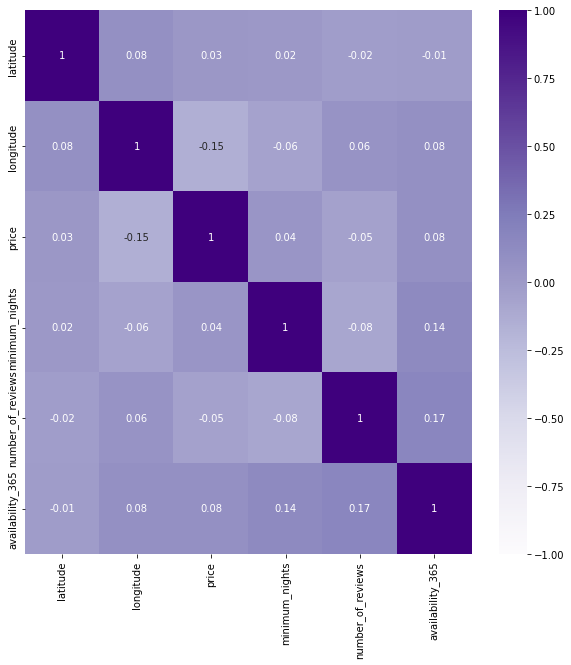

In [ ]:
#Create a correlation matrix that measures the linear relationships between the variables
plt.figure(figsize=(10, 10))
correlation_matrix = df.corr().round(2)
sns.heatmap(data=correlation_matrix,annot=True,vmin=-1,cmap='Purples')

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


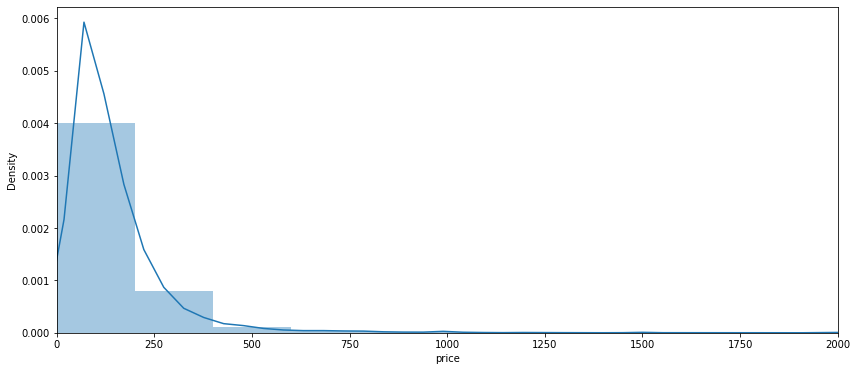

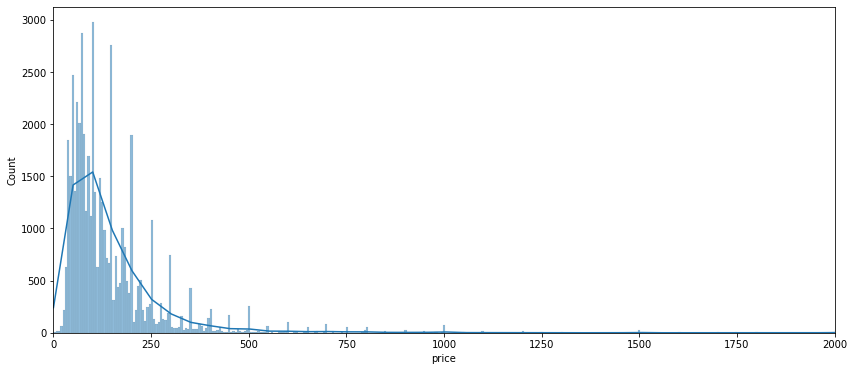

In [ ]:
#Plotting distribution and histogram plot
plt.figure(figsize=(14, 6))
sns.distplot(df['price'])
plt.xlim([0, 2000])
plt.show()
plt.figure(figsize=(14, 6))
sns.histplot(df['price'], kde = True)
plt.xlim([0, 2000])
plt.show()

In [ ]:
#Find the unique elements of an array
df.room_type.unique()

array(['Private room', 'Entire home/apt', 'Shared room'], dtype=object)

In [ ]:
#Count each room type
df['room_type'].value_counts()

Entire home/apt    25409
Private room       22326
Shared room         1160
Name: room_type, dtype: int64

In [ ]:
#Group by neighbourhood_group and room_type and count
city_room_type = df.groupby(['neighbourhood_group'])['room_type'].value_counts().unstack(0)
print(city_room_type)

neighbourhood_group  Bronx  Brooklyn  Manhattan  Queens  Staten Island
room_type                                                             
Entire home/apt        379      9559      13199    2096            176
Private room           652     10132       7982    3372            188
Shared room             60       413        480     198              9


Text(0.5, 1.0, 'City with room types')

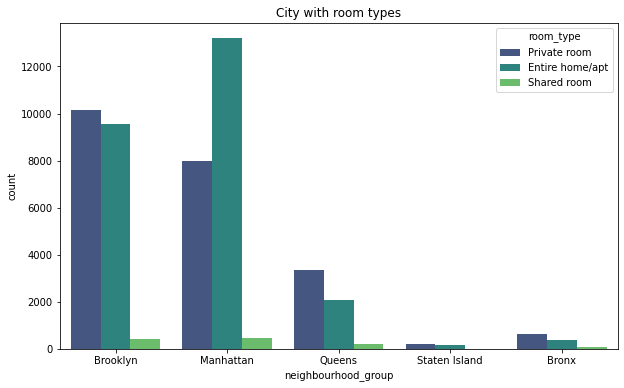

In [ ]:
#Plot number of each room type for different cities
plt.figure(figsize=(10,6))
ax = sns.countplot(data=df,x='neighbourhood_group',hue='room_type',palette='viridis')
plt.title('City with room types')

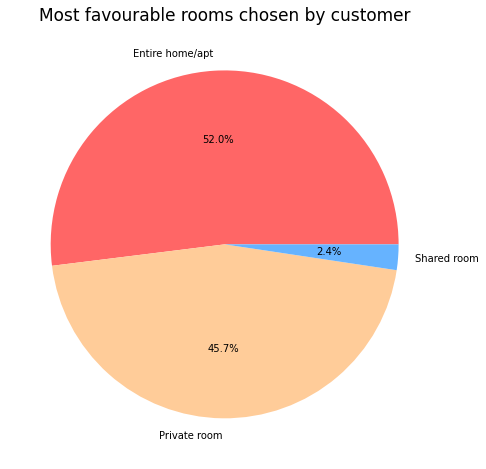

In [ ]:
#Plotting a pie chart to find the rooms that customers choose the most
labels = df['room_type'].value_counts().index
sizes = df['room_type'].value_counts().values
plt.figure(figsize = (8,8))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', colors = ['#ff6666','#ffcc99','#66b3ff'] )
plt.title("Most favourable rooms chosen by customer", color = 'black',fontsize = 17);

Text(0.5, 1.0, 'Total number of rooms in each city')

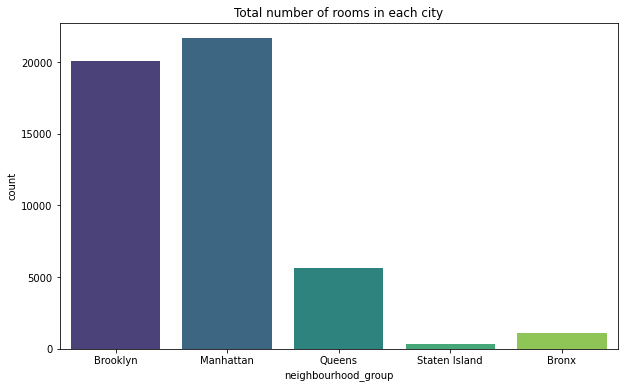

In [ ]:
#Plot total number of rooms for each city
plt.figure(figsize=(10,6))
ax = sns.countplot(data=df,x='neighbourhood_group',palette='viridis')
plt.title('Total number of rooms in each city')

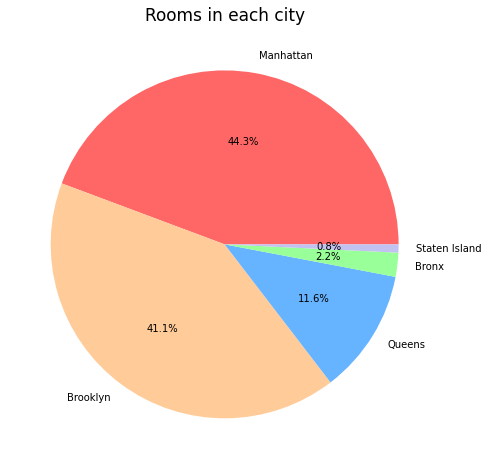

In [ ]:
#Create a pie chart on rooms in each city
labels = df['neighbourhood_group'].value_counts().index
sizes = df['neighbourhood_group'].value_counts().values
plt.figure(figsize = (8,8))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', colors = ['#ff6666','#ffcc99','#66b3ff','#99ff99','#c2c2f0'] )
plt.title("Rooms in each city", color = 'black',fontsize = 17);

In [ ]:
#Calculate the average price for each room type
avg_price_type = df.groupby('room_type', as_index=False)[['price']].mean()
avg_price_type.rename(columns={'room_type':'Room Type','price':'Avg Price'},inplace=True)
avg_price_type


,Room Type,Avg Price
0,Entire home/apt,211.794246
1,Private room,89.780973
2,Shared room,70.127586


In [ ]:
#Calculate the average price for each room type in different cities
avg_price_city_type = df.groupby(['neighbourhood_group','room_type'], as_index=False)[['price']].mean()
avg_price_city_type.rename(columns={'neighbourhood_group':'City','room_type':'Room Type','price':'Avg Price'},inplace=True)
avg_price_city_type

,City,Room Type,Avg Price
0,Bronx,Entire home/apt,127.506596
1,Bronx,Private room,66.788344
2,Bronx,Shared room,59.800000
3,Brooklyn,Entire home/apt,178.327545
4,Brooklyn,Private room,76.500099
5,Brooklyn,Shared room,50.527845
6,Manhattan,Entire home/apt,249.239109
7,Manhattan,Private room,116.776622
8,Manhattan,Shared room,88.977083
9,Queens,Entire home/apt,147.050573


Text(0.5, 1.0, 'Average price for different room types')

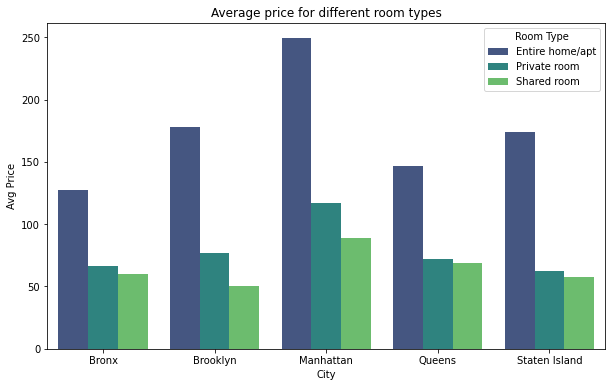

In [ ]:
#Barplot Avg Price vs City vs Room Type
plt.figure(figsize=(10,6))
ax = sns.barplot(data=avg_price_city_type,x='City',y='Avg Price',hue='Room Type',palette='viridis')
plt.title('Average price for different room types')

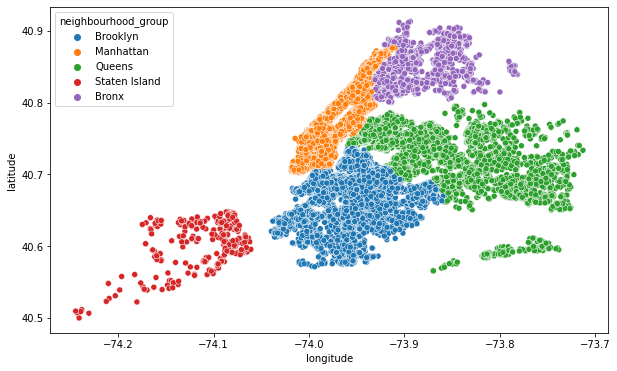

In [ ]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df.longitude,y=df.latitude,hue=df.neighbourhood_group)

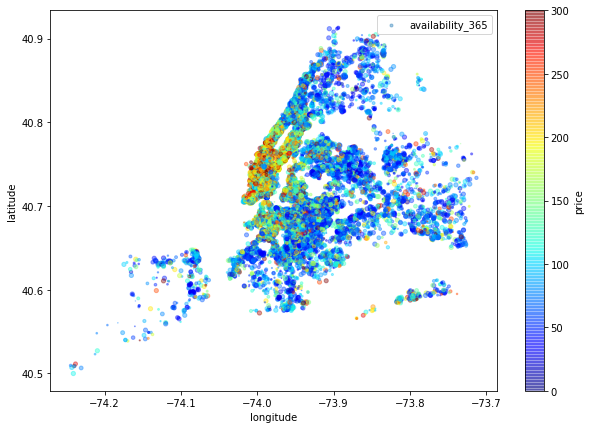

In [ ]:
df_price_cap = df[df['price']<=300]

df_price_cap.plot(kind="scatter", x="longitude", y="latitude", alpha=0.4,
    s=df_price_cap["availability_365"]/20, label="availability_365", figsize=(10,7),
    c="price", cmap=plt.get_cmap("jet"), colorbar=True,
    sharex=False)
plt.legend()

In [ ]:
# check interactive object distribution on the map

import folium
from folium import plugins

# nyc latitude, longitude
latitude = 40.73
longitude = -73.94

# let's start again with a clean copy of the map of San Francisco
nyc_map = folium.Map(location = [latitude, longitude], zoom_start = 12)

# instantiate a mark cluster object for the incidents in the dataframe
incidents = plugins.MarkerCluster().add_to(nyc_map)

# loop through the dataframe and add each data point to the mark cluster
for lat, lng in zip(df.latitude, df.longitude):
    folium.Marker(
        location=[lat, lng],
        icon=None
    ).add_to(incidents)

# add incidents to map
nyc_map.add_child(incidents)